In [105]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

The multivariate normal, multinormal or Gaussian distribution is a generalization of the one-dimensional normal distribution to higher dimensions. Such a distribution is specified by its mean and
covariance matrix. These parameters are analogous to the mean (average or "center") and variance (standard deviation, or "width," squared) of the one-dimensional normal distribution.

# 

Read the files labeled as 'sampleX.txt' using numpy or pandas and plot them.

In [24]:
import pandas as pd

In [25]:
sample_1=pd.read_csv('sample1.txt', delimiter = '\t')
sample_2=pd.read_csv('sample2.txt',delimiter = '\t')
sample_3=pd.read_csv('sample3.txt',delimiter = '\t')

In [26]:
print(sample_1)

               x         y
0      -0.354943  0.170799
1       1.223883  0.069030
2       2.422117  1.735389
3       0.569559  0.788981
4       0.802705  1.389530
...          ...       ...
999995  0.197505 -0.032674
999996  1.592318  1.861550
999997  0.397048  0.995460
999998  2.787388  0.784992
999999 -0.032019  2.587470

[1000000 rows x 2 columns]


In [7]:
sample_1.head()


,x,y
0,-0.354943,0.170799
1,1.223883,0.069030
2,2.422117,1.735389
3,0.569559,0.788981
4,0.802705,1.389530


In [8]:
sample_2.head()

,x,y
0,0.870248,0.359338
1,-0.570291,1.137400
2,1.319536,-2.333256
3,-1.041993,-1.397937
4,-0.267094,-1.100576


In [9]:
sample_3.head()

,x,y
0,1.006065,1.015372
1,0.672018,0.901308
2,-0.979334,0.248954
3,0.724723,1.607615
4,-0.845421,-1.495763


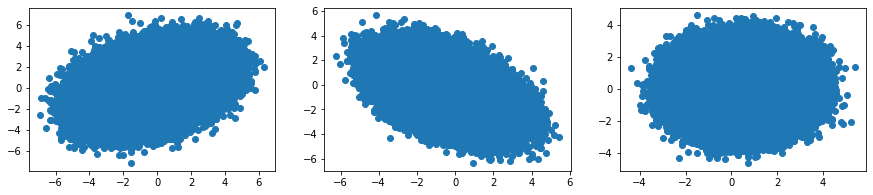

In [27]:
%matplotlib inline
plt.figure(figsize=(15, 3))
x1=sample_1['x']
y1=sample_1['y']
x2=sample_2['x']
y2=sample_2['y']
x3=sample_3['x']
y3=sample_3['y']
plt.subplot(131)
plt.scatter(x1, y1)
plt.subplot(132)
plt.scatter(x2, y2)
plt.subplot(133)
plt.scatter(x3, y3)
plt.show()


Determine whether each sample is correlated, anticorrelated or uncorrelated.

In [ ]:
#knowing that:
    #correlation>0:correlated
    #correlation<0:anticorrelatad
    #correlation=0:uncorrelatad

In [101]:
from numpy.random import randn
from scipy.stats import pearsonr

In [82]:

corr1, _ = pearsonr(x1, y1)
print('sample_1 correlation: %.3f' % corr1)


sample_1 correlation: 0.326


In [84]:
corr2, _ = pearsonr(x2, y2)
print('sample_2 correlation: %.3f' % corr2)

sample_2 correlation: -0.472


In [85]:
corr3, _ = pearsonr(x3, y3)
print('sample_3 correlation: %.3f' % corr3)

sample_3 correlation: 0.031


## 3d Plot
Plot the joint probability distribution of each sample in 3D. For this you can use 'plot_surface' found in matplotlib library.

If you want to plot using matplotlib, the codes below will come in handy. First line makes sure that your plots are interactive, second line provides color maps.

In [132]:
%matplotlib notebook
from matplotlib import cm
import plotly.express as px
import seaborn as sns
from scipy.stats import multivariate_normal

At the first step try to get the 2D histogram of your data. (Hint: beware of different sizes of arrays!)

<IPython.core.display.Javascript object>


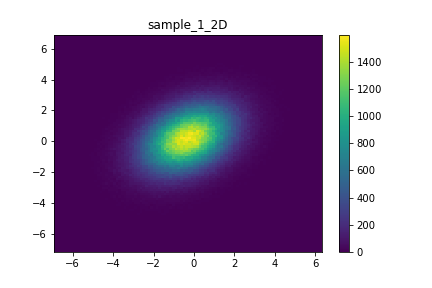

In [78]:
plt.hist2d(x1,y1,bins = 100)
plt.title("sample_1_2D")
plt.savefig("histogram_2d_01.png", bbox_inches='tight')
plt.colorbar()
plt.show()

<IPython.core.display.Javascript object>


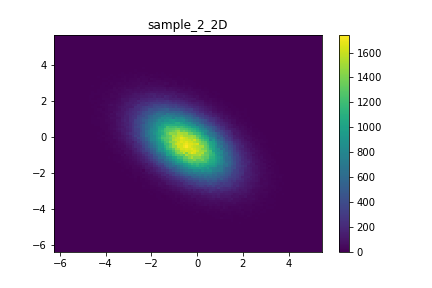

In [75]:
plt.hist2d(x2,y2,bins = 100)
plt.title("sample_2_2D")
plt.savefig("histogram_2d_02.png", bbox_inches='tight')
plt.colorbar()
plt.show()

<IPython.core.display.Javascript object>


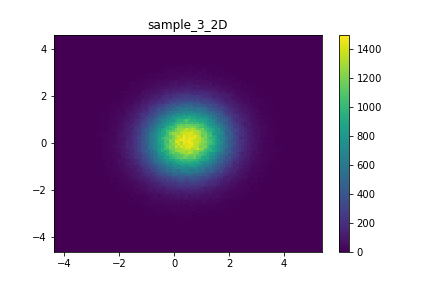

In [79]:
plt.hist2d(x3,y3,bins = 100)
plt.title("sample_3_2D")
plt.savefig("histogram_2d_03.png", bbox_inches='tight')
plt.colorbar()
plt.show()

Now you can plot the 3D histogram:

<IPython.core.display.Javascript object>


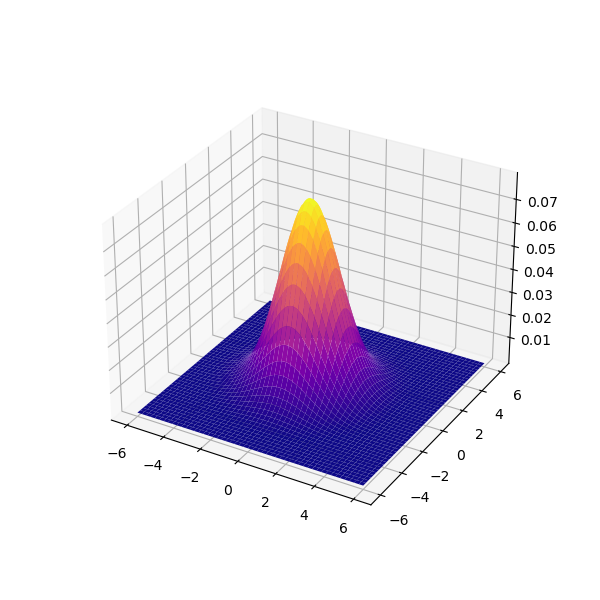

In [81]:
import matplotlib
import statistics
matplotlib.rc_file_defaults()

fig = plt.figure(figsize=(6,6))
ax = plt.axes(projection='3d')
x=np.linspace(-6,6,1000)
y=np.linspace(-6,6,1000)
X,Y = np.meshgrid(x,y)
x1_mean=np.mean(x1)
x1_var=statistics.variance(x1)
y1_mean=np.mean(y1)
y1_var=statistics.variance(y1)
pos = np.empty(X.shape+(2,))
pos[:,:,0]=X
pos[:,:,1]=Y
rv1 = multivariate_normal([x1_mean, y1_mean],[[x1_var, 0], [0, y1_var]])
ax.plot_surface(X,Y,rv1.pdf(pos) , cmap="plasma")
plt.show()


<IPython.core.display.Javascript object>


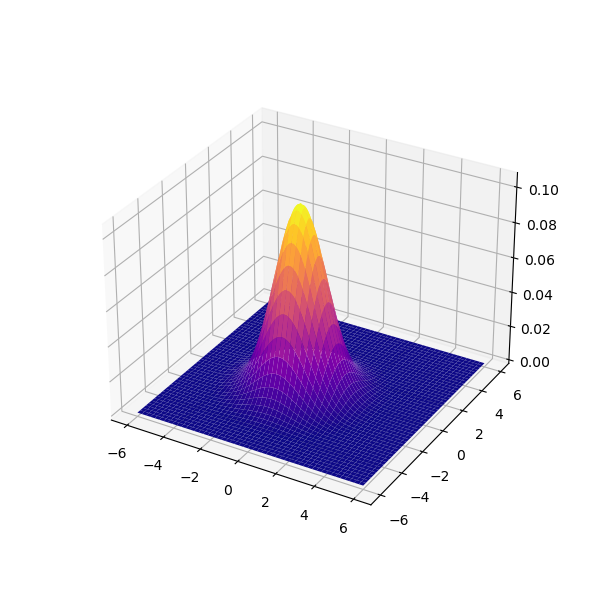

In [18]:

fig = plt.figure(figsize=(6, 6))
ax = plt.axes(projection='3d')
x2_mean=np.mean(x2)
x2_var=statistics.variance(x2)
y2_mean=np.mean(y2)
y2_var=statistics.variance(y2)
rv2 = multivariate_normal([x2_mean, y2_mean],[[x2_var, 0], [0, y2_var]])
ax.plot_surface(X,Y, rv2.pdf(pos), cmap="plasma")
plt.show()

<IPython.core.display.Javascript object>


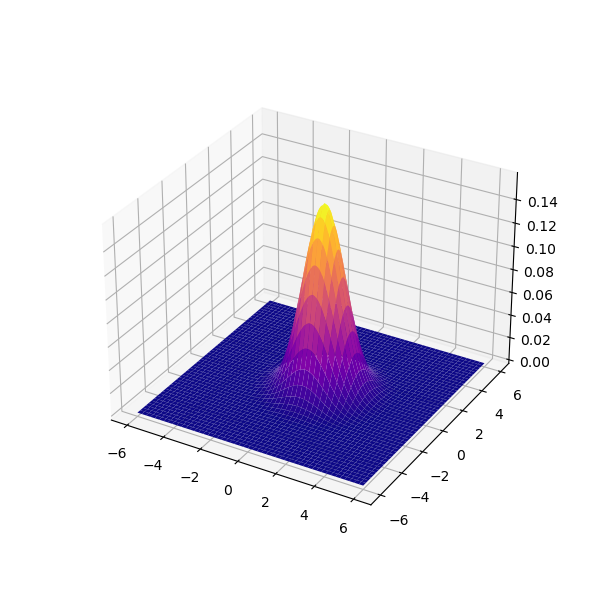

In [45]:
fig = plt.figure(figsize=(6, 6))
ax = plt.axes(projection='3d')
x3_mean=np.mean(x3)
x3_var=statistics.variance(x3)
y3_mean=np.mean(y3)
y3_var=statistics.variance(y3)
rv3 = multivariate_normal([x3_mean, y3_mean],[[x3_var, 0], [0, y3_var]])
ax.plot_surface(X,Y, rv3.pdf(pos), cmap="plasma")
plt.show()


Using the calculated histograms, now write a code to calculate the marginalized PDFs along both axes and then plot them.

In [22]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px
df = px.data.tips()


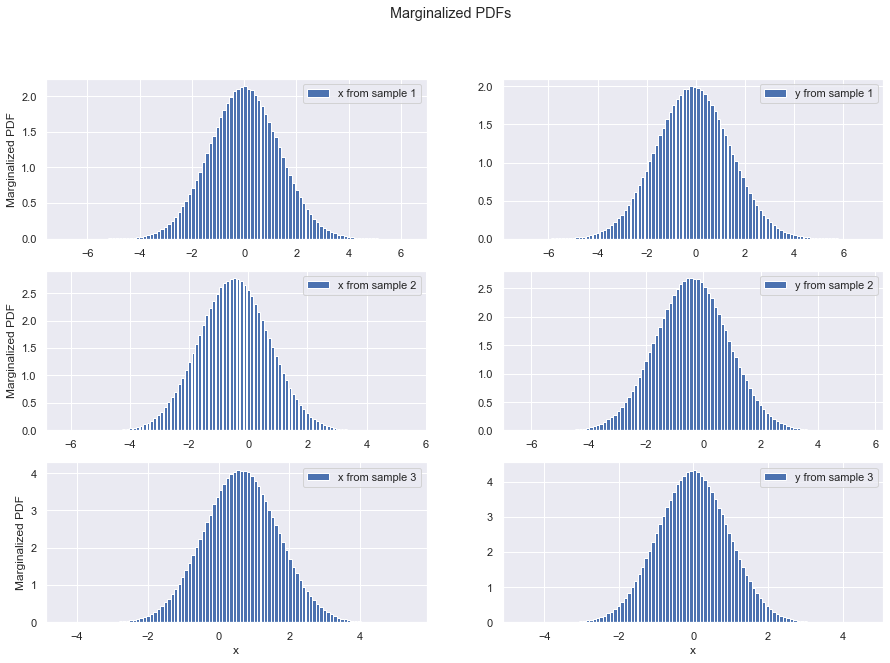

In [15]:
%matplotlib inline
sns.set() #Use this line to plot the marginalized PDFs with seaborn style

plt.figure(figsize=(15, 10))
plt.suptitle('Marginalized PDFs')

plt.subplot(321)
...
...


plt.show()

In [29]:
z1=rv1.pdf(pos)
z2=rv2.pdf(pos)
z3=rv3.pdf(pos)
print(z1.shape)
m1=np.sum(z1,axis=1)
print(m1)


(1000, 1000)
[1.58945875e-03 1.64964507e-03 1.71198699e-03 1.77655682e-03
 1.84342910e-03 1.91268068e-03 1.98439076e-03 2.05864100e-03
 2.13551552e-03 2.21510104e-03 2.29748691e-03 2.38276518e-03
 2.47103068e-03 2.56238112e-03 2.65691712e-03 2.75474234e-03
 2.85596352e-03 2.96069058e-03 3.06903671e-03 3.18111843e-03
 3.29705573e-03 3.41697209e-03 3.54099465e-03 3.66925423e-03
 3.80188549e-03 3.93902697e-03 4.08082125e-03 4.22741499e-03
 4.37895911e-03 4.53560881e-03 4.69752376e-03 4.86486817e-03
 5.03781088e-03 5.21652555e-03 5.40119072e-03 5.59198993e-03
 5.78911189e-03 5.99275056e-03 6.20310529e-03 6.42038098e-03
 6.64478816e-03 6.87654320e-03 7.11586837e-03 7.36299203e-03
 7.61814878e-03 7.88157955e-03 8.15353185e-03 8.43425981e-03
 8.72402442e-03 9.02309364e-03 9.33174260e-03 9.65025373e-03
 9.97891694e-03 1.03180298e-02 1.06678977e-02 1.10288341e-02
 1.14011604e-02 1.17852067e-02 1.21813115e-02 1.25898219e-02
 1.30110941e-02 1.34454934e-02 1.38933945e-02 1.43551813e-02
 1.48312479

## Extra example:

You can also combine the two steps above and plot the joint PDF and the marginalized ones altogether using seaborn.

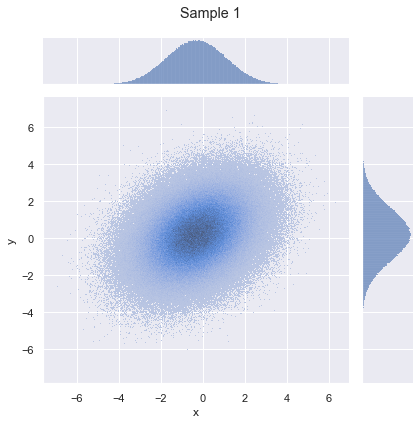

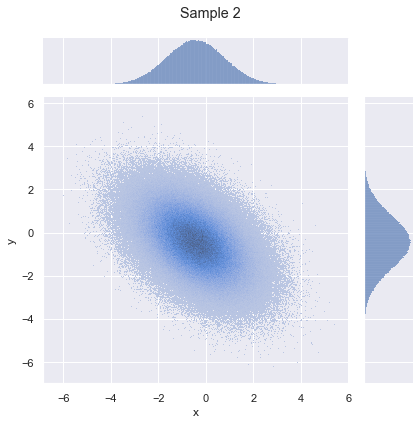

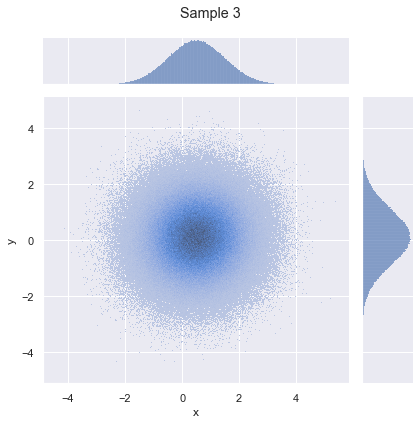

In [16]:
g1 = sns.jointplot(data=s1, x='x', y='y', kind='hist')
g1.fig.suptitle('Sample 1')
g1.fig.tight_layout()

g2 = sns.jointplot(data=s2, x='x', y='y', kind='hist')
g2.fig.suptitle('Sample 2')
g2.fig.tight_layout()

g3 = sns.jointplot(data=s3, x='x', y='y', kind='hist')
g3.fig.suptitle('Sample 3')
g3.fig.tight_layout()

plt.show()

## Contour Plots

Plot the contours of the datasets showing different values of contours.

<IPython.core.display.Javascript object>


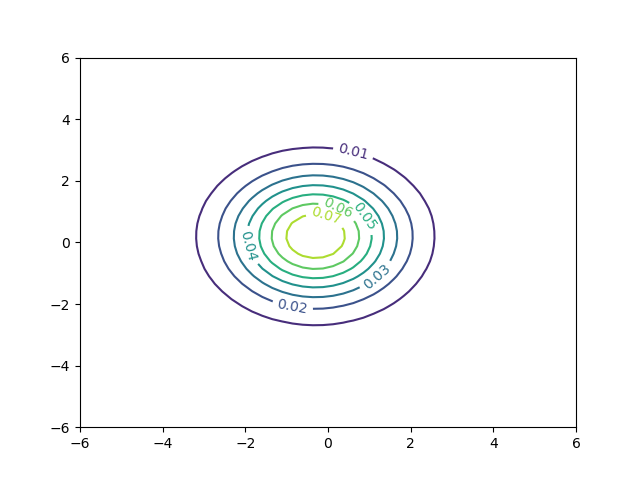

<a list of 7 text.Text objects>

In [149]:
%matplotlib notebook
matplotlib.rc_file_defaults() #Use this line to revert back to matplotlib default style
fig, ax = plt.subplots()
CS = ax.contour(X, Y,rv1.pdf(pos) )
ax.clabel(CS, inline=True, fontsize=10)


<IPython.core.display.Javascript object>


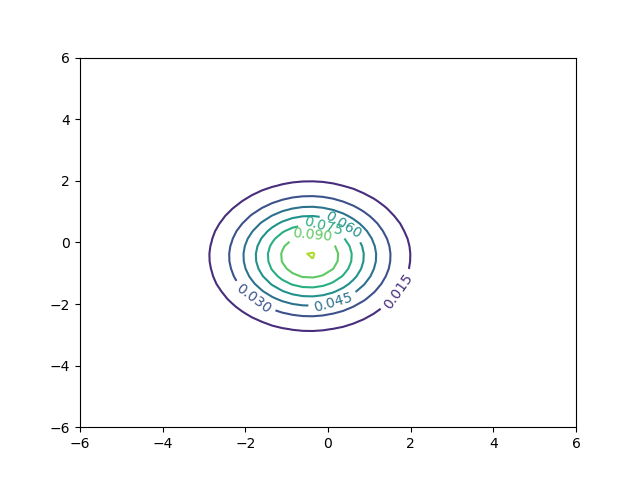

<a list of 6 text.Text objects>

In [150]:
fig, ax = plt.subplots()
CS = ax.contour(X, Y,rv2.pdf(pos) )
ax.clabel(CS, inline=True, fontsize=10)


<IPython.core.display.Javascript object>


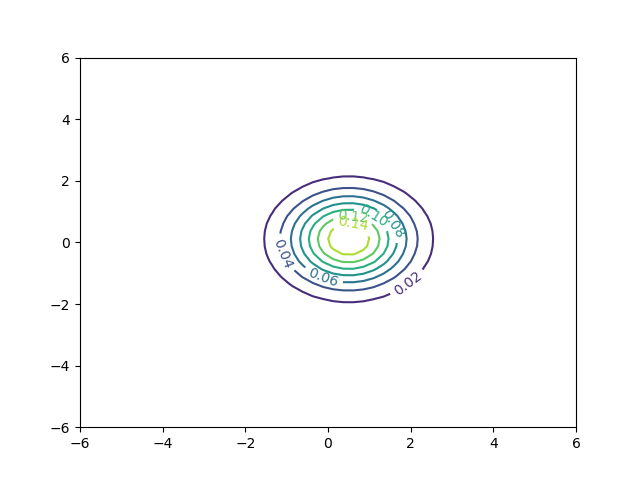

<a list of 7 text.Text objects>

In [152]:
fig, ax = plt.subplots()
CS = ax.contour(X, Y,rv3.pdf(pos) )
ax.clabel(CS, inline=True, fontsize=10)


## 3 parts
In the multivariate case, a gaussian distribution is defined via a mean and a covrience matrix. Here the covarience matrix is the equivalant of varience in higher dimensions. To refresh your mind, take a look at the [Wikipedia page](https://en.wikipedia.org/wiki/Multivariate_normal_distribution#Notation_and_parameterization). A correlation matrix is very similiar but has some [subtle differences](https://en.wikipedia.org/wiki/Correlation#Correlation_matrices). 

Now using those defenitions, find the **covariance** (part 1) and **correlation** (part 2) matrices for each distribution. Are they the same? why? (part 3)

(Hint 1: You may find scipy.stats useful)

(Hint 2: Study the lecture note titled: 'parameter estimation 7' once more)

(Hint 3: [This lecture note](https://pages.ucsd.edu/~rlevy/lign251/fall2007/lecture_4.pdf) may also be useful, althogh the codes aren't written in python)

In [134]:
import scipy
from scipy import stats

In [41]:
#covariance&correlation matrix for sample_1:
corrMatrix_1 = sample_1.corr()
covMatris_1= sample_1.cov()
print("correlation matrix_1:")
print(corrMatrix_1)
print("covariance matrix_1:")
print(covMatris_1)

correlation matrix_1:
          x         y
x  1.000000  0.325752
y  0.325752  1.000000
covariance matrix_1:
          x         y
x  1.999031  0.651621
y  0.651621  2.001686


In [42]:
#covariance&correlation matrix for sample_2:
corrMatrix_2 = sample_2.corr()
covMatris_2= sample_2.cov()
print("correlation matrix_2:")
print(corrMatrix_2)
print("covariance matrix_2:")
print(covMatris_2)

correlation matrix_2:
          x         y
x  1.000000 -0.472396
y -0.472396  1.000000
covariance matrix_2:
          x         y
x  1.503789 -0.710057
y -0.710057  1.502408


In [43]:
#covariance&correlation matrix for sample_3:
corrMatrix_3 = sample_3.corr()
covMatris_3= sample_3.cov()
print("correlation matrix_3:")
print(corrMatrix_3)
print("covariance matrix_3:")
print(covMatris_3)

correlation matrix_3:
         x        y
x  1.00000  0.03108
y  0.03108  1.00000
covariance matrix_3:
          x         y
x  0.999662  0.031059
y  0.031059  0.998979



## 2 parts

Now, only focus on the positievly correlated distribution. If the errors along both of the axes are huge, (as discussed in the lecture 'parameter estimation 7'), Is there a linear combination of the two parameters that can be well constrained? Discuss it (part 1).  Find the mode of the distribution (part 2)

In [21]:
چنانچه ماتریس ضرایب بسط را قطری کنیم و بیضی با کاملا عمودی یا افقی کنیم،  راستای قطر کوچکتر بیضی پارامتر مناسبی برای استخراج اطلاعات است.


# Real World
let's apply this to real world data and using house price data. first import house_data.csv

In [10]:
#Code here
df =pd.read_csv('House_price.csv')
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


you can see detail of your dataframe with the code below

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

Now select the columns of the train set with numerical data

In [12]:
#Code here
numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
df_num = df.select_dtypes(include=numerics)

In [13]:
list(df_num.columns)

['Id',
 'MSSubClass',
 'LotFrontage',
 'LotArea',
 'OverallQual',
 'OverallCond',
 'YearBuilt',
 'YearRemodAdd',
 'MasVnrArea',
 'BsmtFinSF1',
 'BsmtFinSF2',
 'BsmtUnfSF',
 'TotalBsmtSF',
 '1stFlrSF',
 '2ndFlrSF',
 'LowQualFinSF',
 'GrLivArea',
 'BsmtFullBath',
 'BsmtHalfBath',
 'FullBath',
 'HalfBath',
 'BedroomAbvGr',
 'KitchenAbvGr',
 'TotRmsAbvGrd',
 'Fireplaces',
 'GarageYrBlt',
 'GarageCars',
 'GarageArea',
 'WoodDeckSF',
 'OpenPorchSF',
 'EnclosedPorch',
 '3SsnPorch',
 'ScreenPorch',
 'PoolArea',
 'MiscVal',
 'MoSold',
 'YrSold',
 'SalePrice']

Plot the distribution of all the numerical data

C:\Users\Asal\AppData\Local\Temp/ipykernel_6320/1865753230.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1,1, figsize=(50,200))


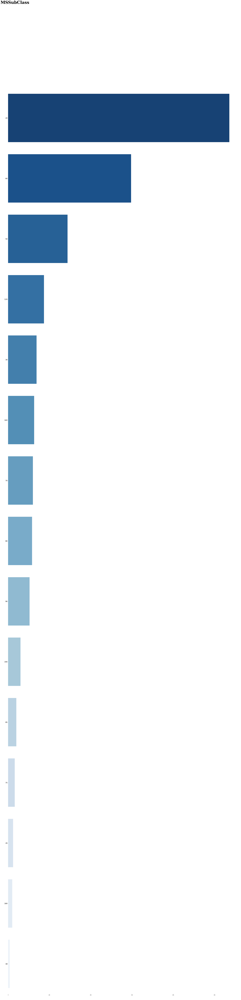

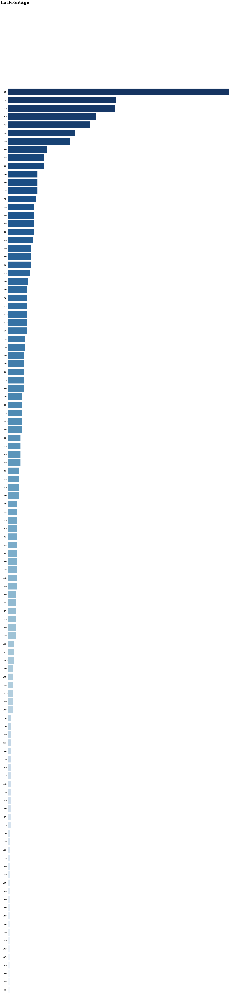

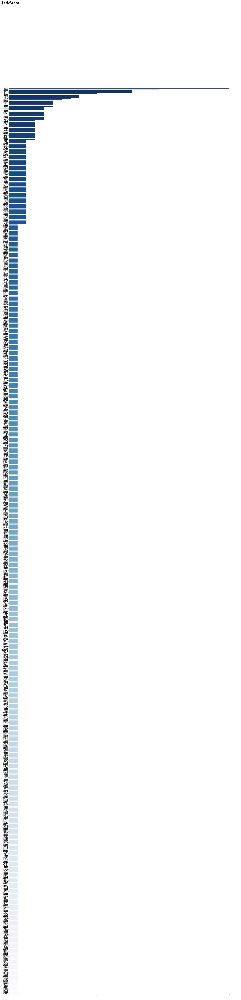

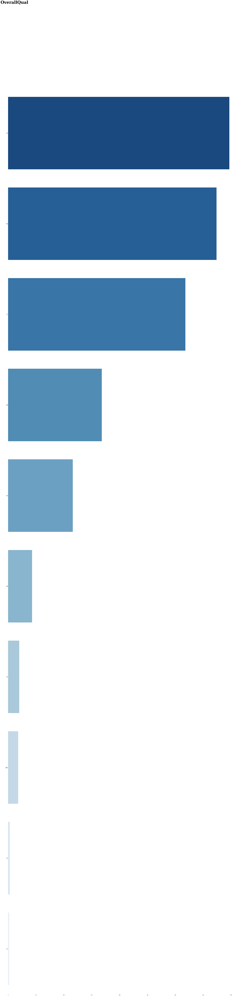

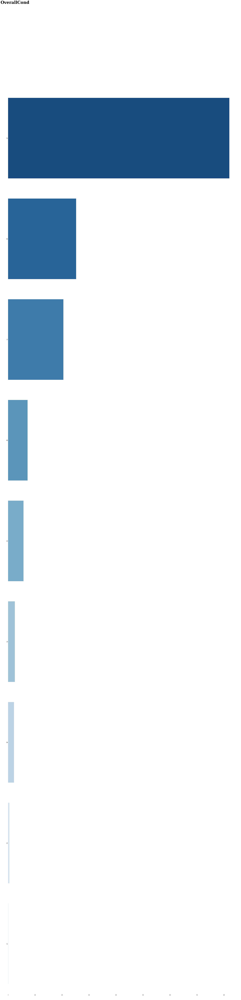

...

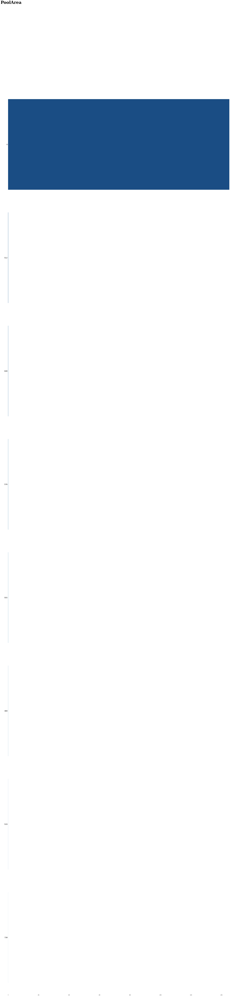

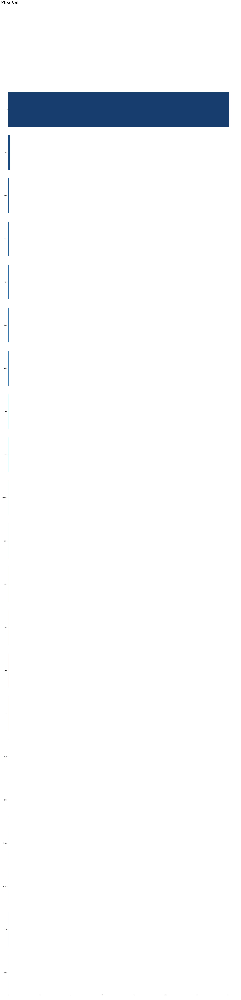

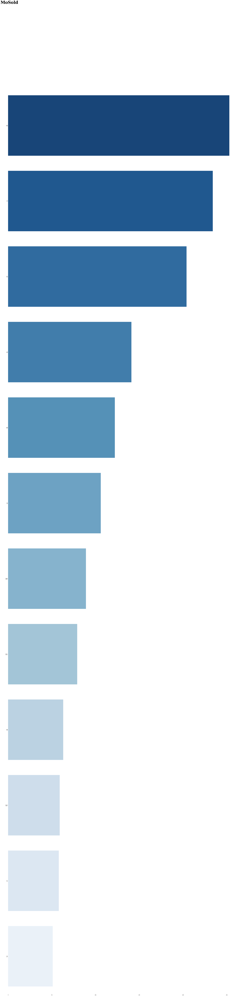

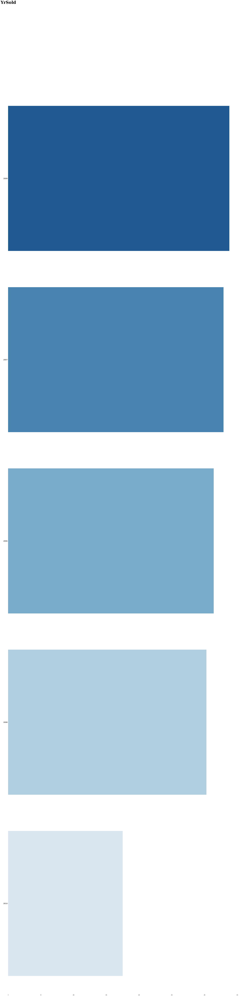

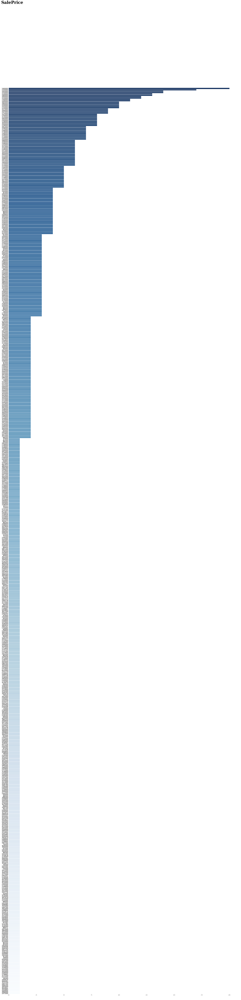

In [22]:
%matplotlib inline

colunas_1 = [ 'MSSubClass','LotFrontage','LotArea','OverallQual','OverallCond','YearBuilt','YearRemodAdd','MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF','GrLivArea','BsmtFullBath','BsmtHalfBath','FullBath','HalfBath','BedroomAbvGr','KitchenAbvGr','TotRmsAbvGrd','Fireplaces','GarageYrBlt','GarageCars','GarageArea','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch','PoolArea','MiscVal','MoSold','YrSold','SalePrice' ]
for i in colunas_1:
    fig, ax = plt.subplots(1,1, figsize=(50,200))
    sns.countplot(y = df[i][1:],data=df.iloc[1:], order=df[i][1:].value_counts().index, palette='Blues_r')
    fig.text(0.1, 0.95,i, fontsize=50, fontweight='bold', fontfamily='serif')
    plt.xlabel(' ', fontsize=45)
    plt.ylabel('  ')
    plt.yticks(fontsize=20)
    plt.box(False)

# ابعاد نمودار ها بزرگ است تا حدالامکان اعداد محور عمودی خوانا باشد

plot Heatmap for all the remaining numerical data including the 'SalePrice'

C:\Users\Asal\AppData\Local\Temp/ipykernel_6320/1287967050.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_num[i]=df_num[i].dropna()


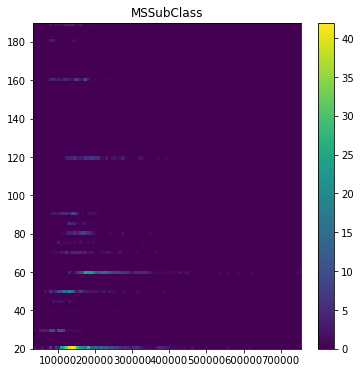

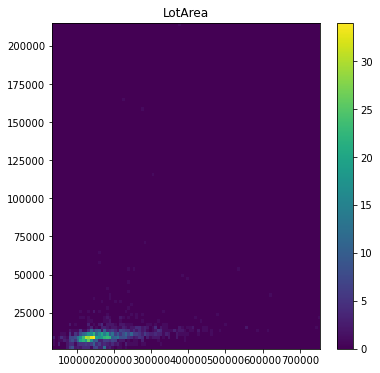

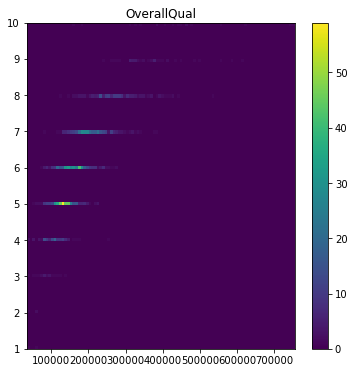

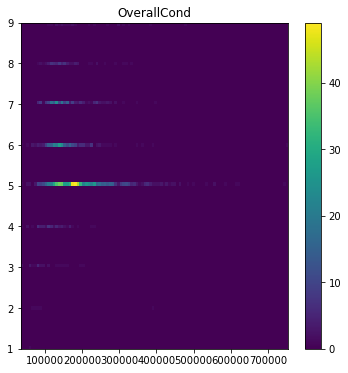

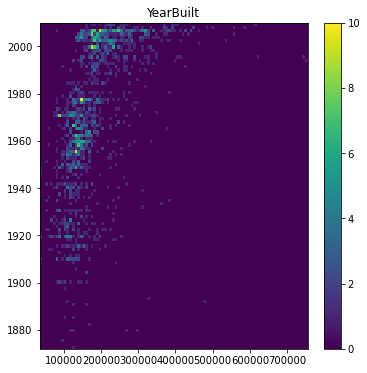

...

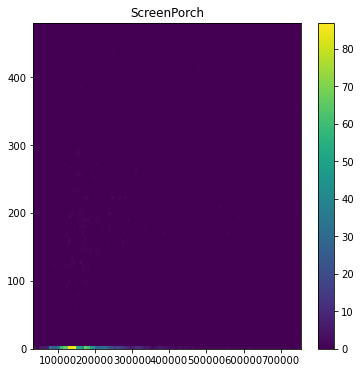

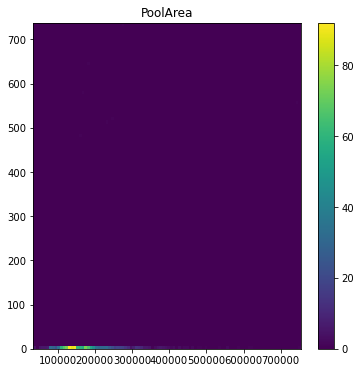

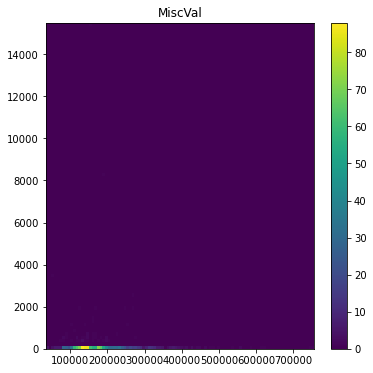

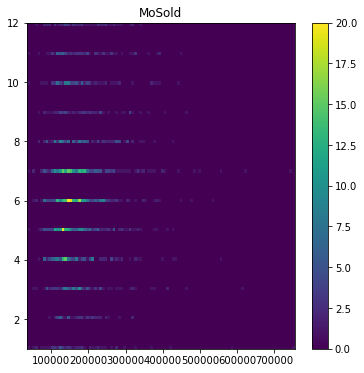

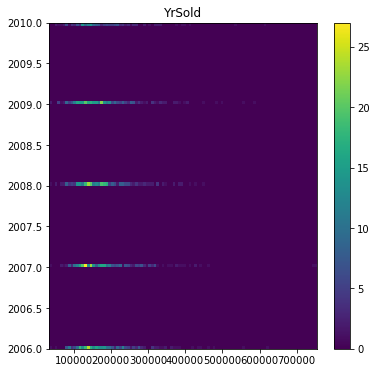

In [99]:
%matplotlib inline
colunas_2 = [ 'MSSubClass','LotArea','OverallQual','OverallCond','YearBuilt','YearRemodAdd','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF','GrLivArea','BsmtFullBath','BsmtHalfBath','FullBath','HalfBath','BedroomAbvGr','KitchenAbvGr','Fireplaces','GarageCars','GarageArea','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch','PoolArea','MiscVal','MoSold','YrSold' ]

x=df_num['SalePrice'].dropna()
for i in colunas_2:
    df_num[i]=df_num[i].dropna()
    fig, ax = plt.subplots(1,1, figsize=(6,6))
    y=df_num[i]
    plt.hist2d(x,y,bins = 100)
    plt.title(i)
    plt.savefig("histogram_2d_4.png", bbox_inches='tight')
    plt.colorbar()
    plt.show()
    

In [147]:
colunas_2 = [ 'MSSubClass','LotArea','OverallQual','OverallCond','YearBuilt','YearRemodAdd','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF','GrLivArea','BsmtFullBath','BsmtHalfBath','FullBath','HalfBath','BedroomAbvGr','KitchenAbvGr','Fireplaces','GarageCars','GarageArea','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch','PoolArea','MiscVal','MoSold','YrSold' ]

x=df_num['SalePrice'].dropna()
for i in colunas_2:
    list_1=[]
    
    y=df_num[i]
    df_num[i]=df_num[i].dropna()
    corr, _ = pearsonr(x, y)
    print(i)
    print(' correlation:' ,corr )
    if corr>0.3:
        print("                                             correlated variable:",i)

    

    
    


MSSubClass
 correlation: -0.08428413512659519
LotArea
 correlation: 0.2638433538714057
OverallQual
 correlation: 0.790981600583805
                                             correlated variable: OverallQual
OverallCond
 correlation: -0.07785589404867803
YearBuilt
 correlation: 0.5228973328794969
                                             correlated variable: YearBuilt
YearRemodAdd
 correlation: 0.5071009671113861
                                             correlated variable: YearRemodAdd
BsmtFinSF1
 correlation: 0.38641980624215333
                                             correlated variable: BsmtFinSF1
BsmtFinSF2
 correlation: -0.01137812145021515
BsmtUnfSF
 correlation: 0.2144791055469689
TotalBsmtSF
 correlation: 0.6135805515591953
                                             correlated variable: TotalBsmtSF
1stFlrSF
 correlation: 0.6058521846919146
                                             correlated variable: 1stFlrSF
2ndFlrSF
 correlation: 0.31933380283206775
      

Now choose Features with high correlation (higher than 0.5) and plot the correlation of each feature with SalePrice

<IPython.core.display.Javascript object>


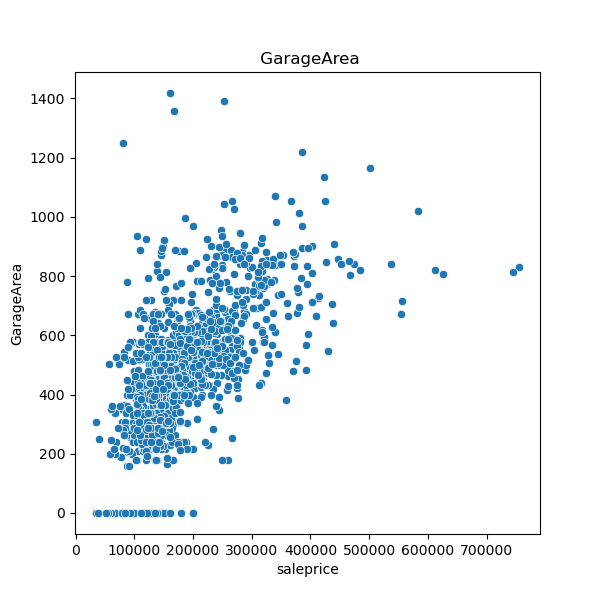

<IPython.core.display.Javascript object>


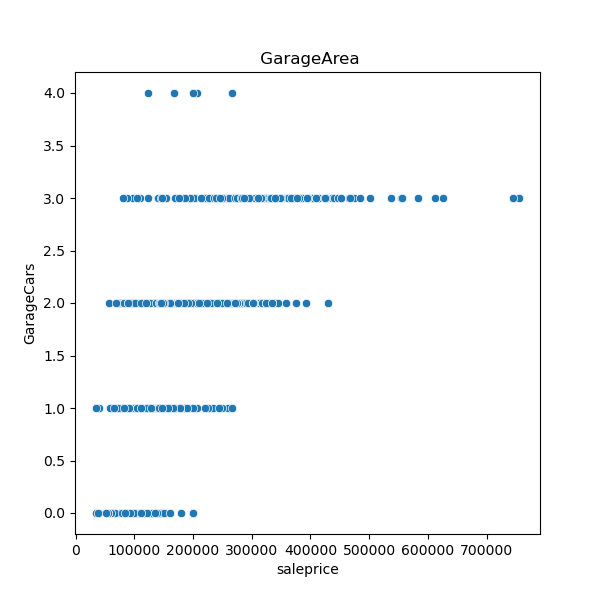

<IPython.core.display.Javascript object>


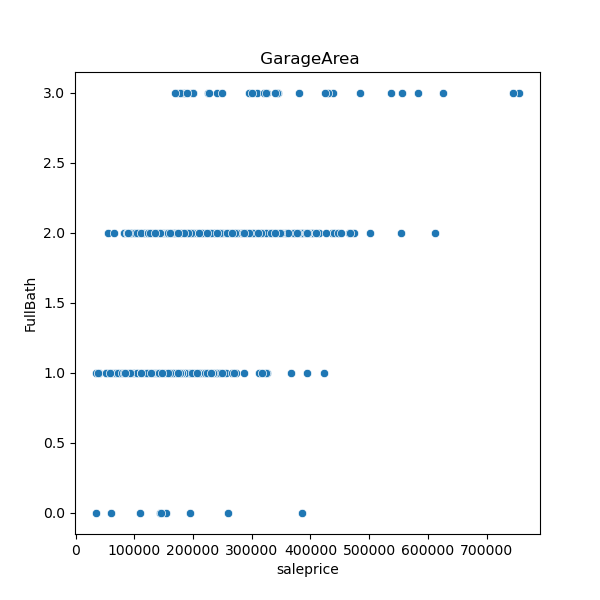

<IPython.core.display.Javascript object>


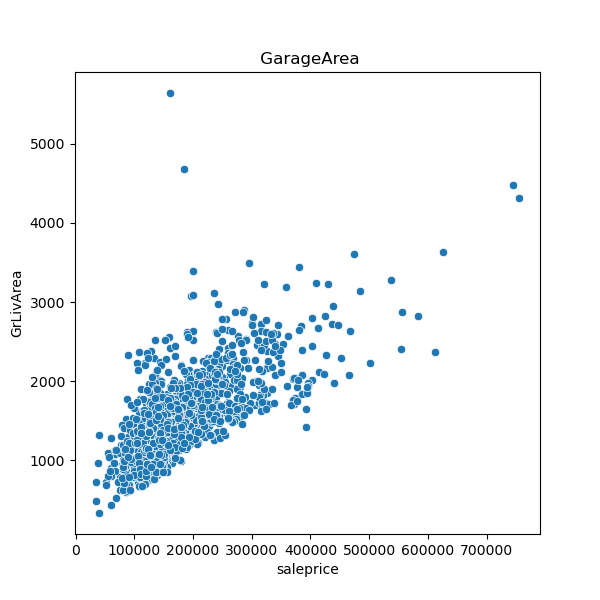

<IPython.core.display.Javascript object>


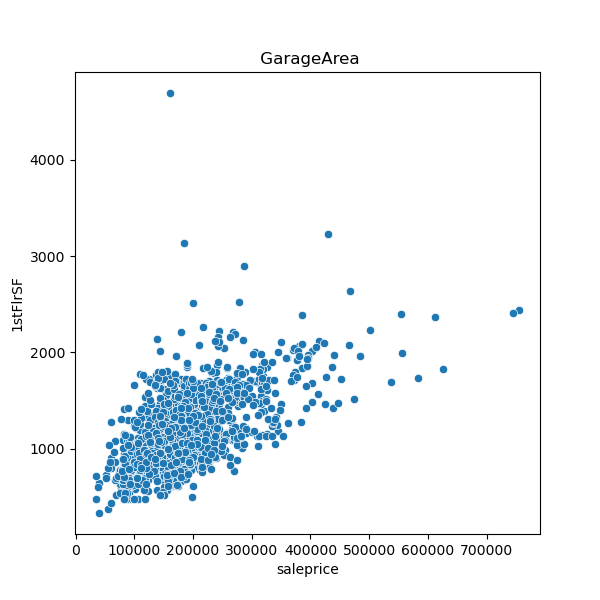

<IPython.core.display.Javascript object>


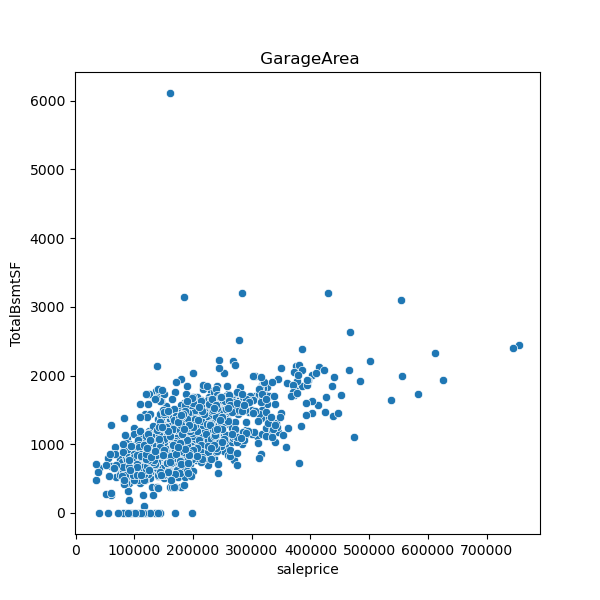

<IPython.core.display.Javascript object>


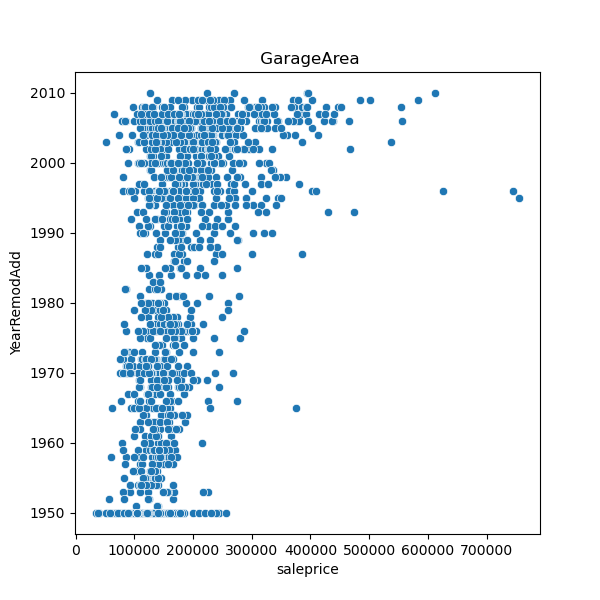

<IPython.core.display.Javascript object>


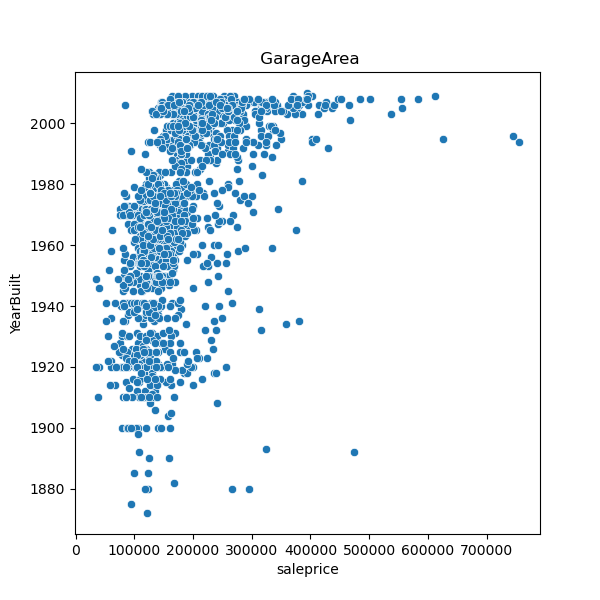

<IPython.core.display.Javascript object>


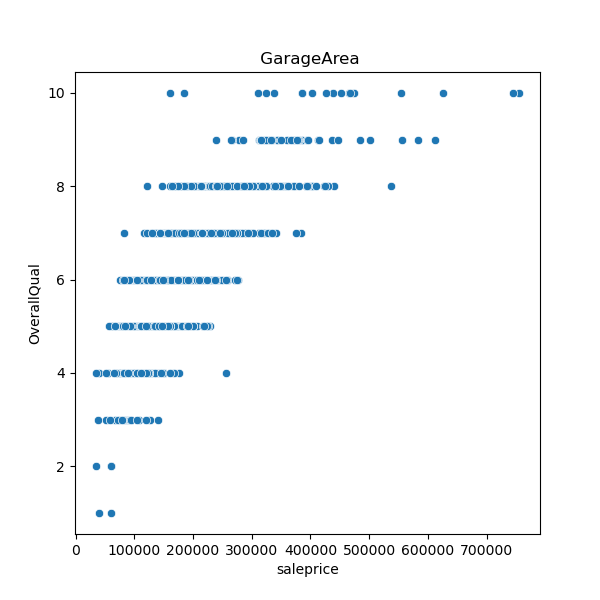

In [171]:
list_2=['GarageArea','GarageCars','FullBath','GrLivArea','1stFlrSF','TotalBsmtSF','YearRemodAdd','YearBuilt','OverallQual']
x=df_num['SalePrice'].dropna()
for p in list_2:
    fig, ax = plt.subplots(1,1, figsize=(6,6))
    y=df_num[p]
    ax = sns.scatterplot(x, y)
    ax.set_title(i)
    ax.set_xlabel("saleprice")
    


    plt.show()

<IPython.core.display.Javascript object>


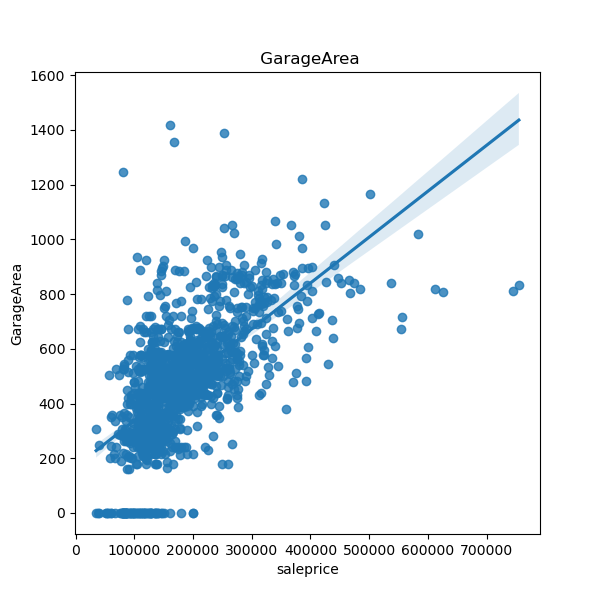

<IPython.core.display.Javascript object>


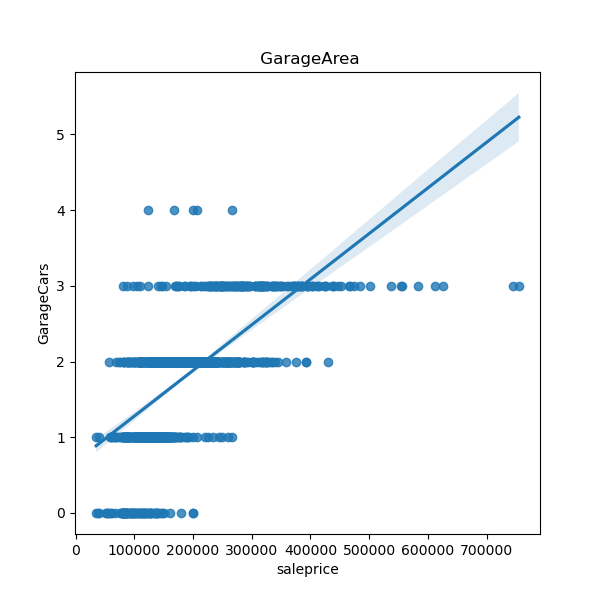

<IPython.core.display.Javascript object>


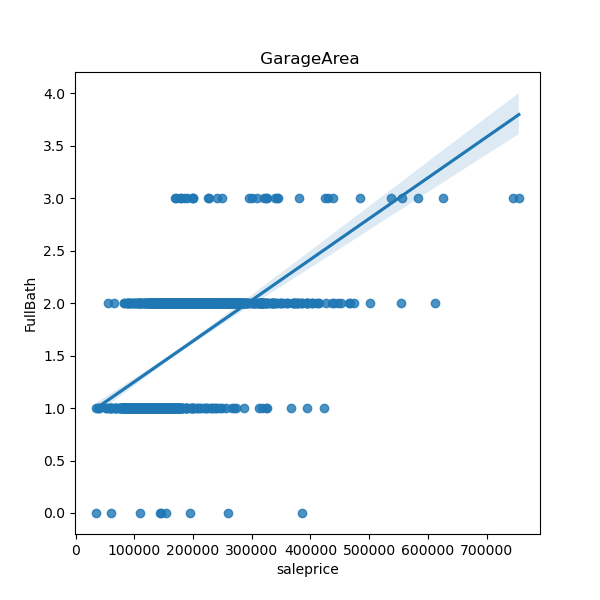

<IPython.core.display.Javascript object>


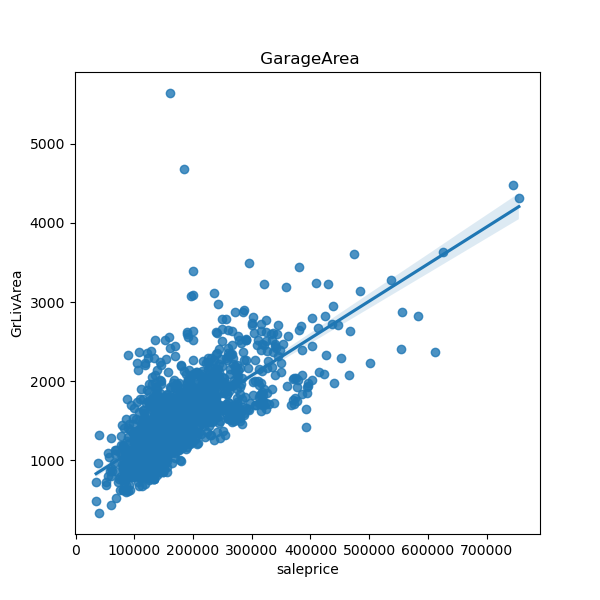

<IPython.core.display.Javascript object>


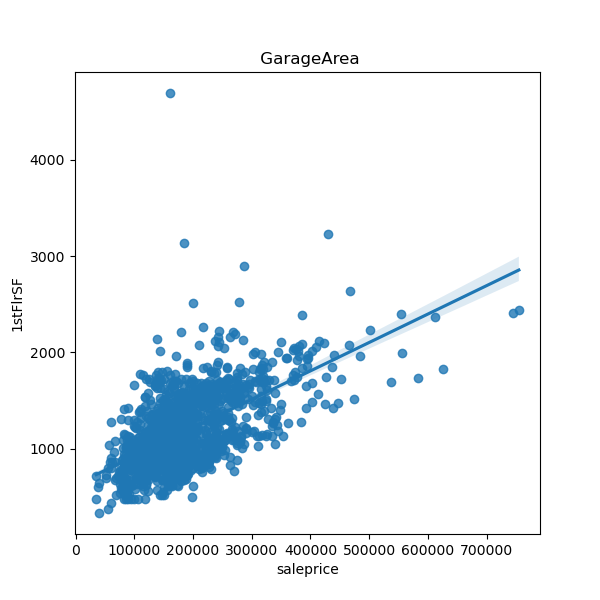

<IPython.core.display.Javascript object>


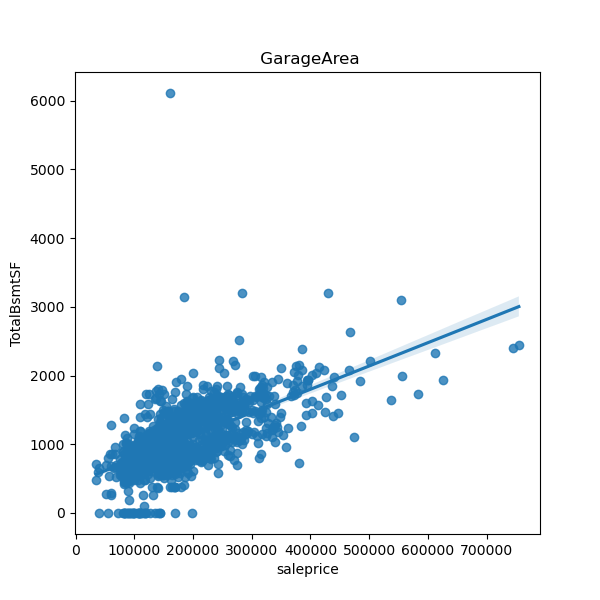

<IPython.core.display.Javascript object>


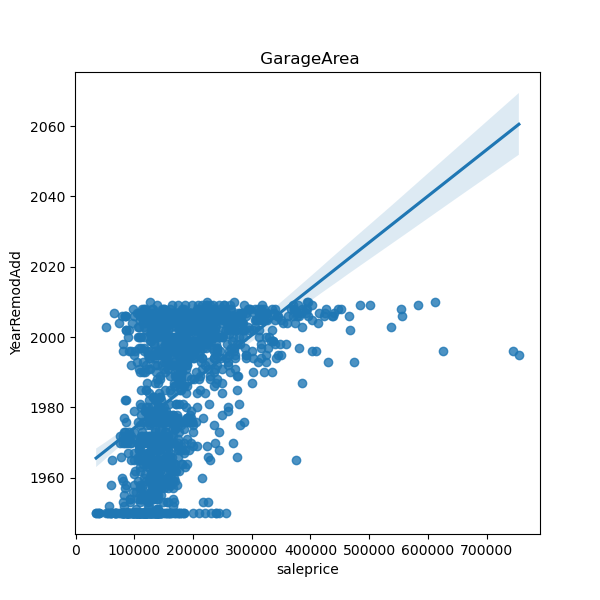

<IPython.core.display.Javascript object>


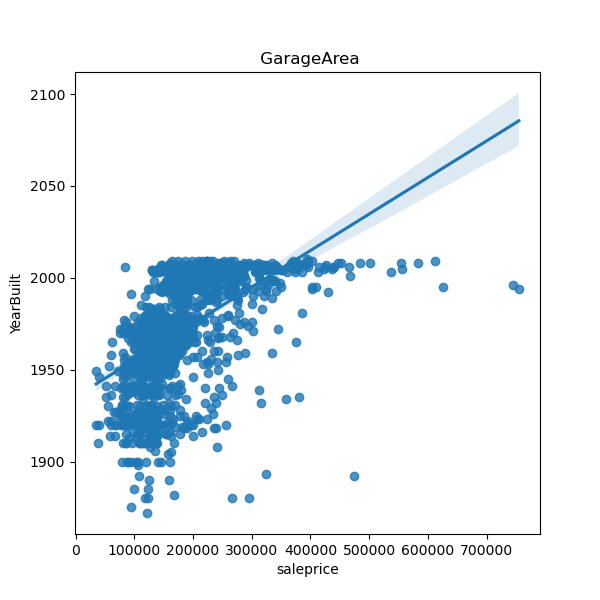

<IPython.core.display.Javascript object>


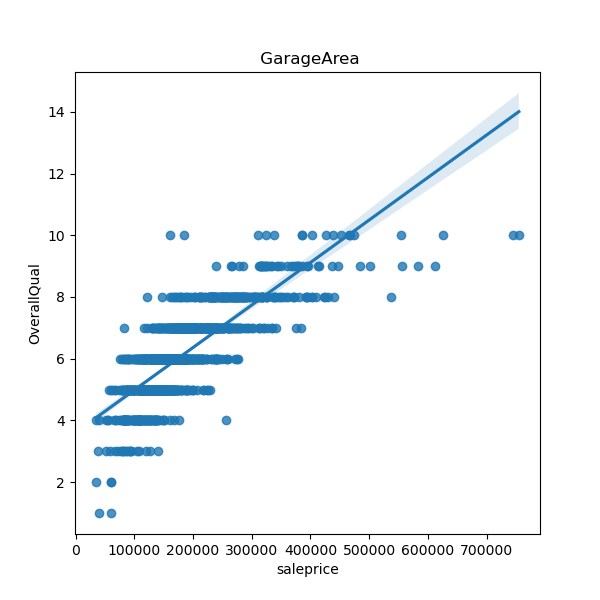

In [170]:
list_2=['GarageArea','GarageCars','FullBath','GrLivArea','1stFlrSF','TotalBsmtSF','YearRemodAdd','YearBuilt','OverallQual']
x=df_num['SalePrice'].dropna()
for p in list_2:
    fig, ax = plt.subplots(1,1, figsize=(6,6))
    y=df_num[p]
    sns.regplot(x, y)
    plt.savefig("Plotting_Correlation_Scatterplot_With_Regression_Fit.jpg")
    ax.set_title(i)
    ax.set_xlabel("saleprice")
    plt.show()

Check the NaN of dataframe set by ploting percent of missing values per column and plot the result

In [6]:
#Code here

in the last session I think Amirreza said that droping Nan cells is not suited in many projects cause
it can remove alots of information of your dataframe. ofcourse he is right and I would like to give a short introduction to the process of handling Nan cells which is called "Imputation". Data imputation is the substitution of estimated values for missing or inconsistent data items (fields). The substituted values are intended to create a data record that does not fail edits. here you can use Simple_

In [ ]:
# Imputation of missing values (NaNs) with SimpleImputer you can check diffrent strategy 
my_imputer = SimpleImputer(strategy="median")
df_num_imputed = pd.DataFrame(my_imputer.fit_transform(df_num))
df_train_imputed.columns = df_train_num.columns

# Categorical features

## Explore and clean Categorical features

find all Catagorical columns. you can use the code for finding the numerical columns and just using 'object' for dtype.

In [74]:
m=df.select_dtypes(include=['object']).columns.tolist()

C:\Users\Asal\AppData\Local\Temp/ipykernel_2324/1880155133.py:4: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



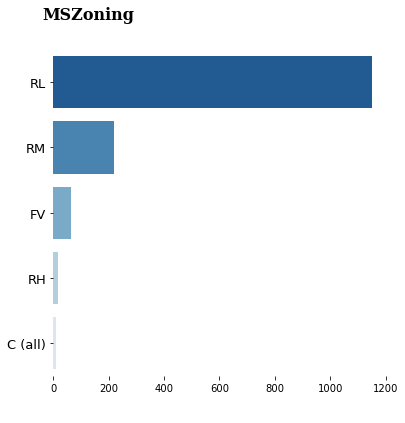

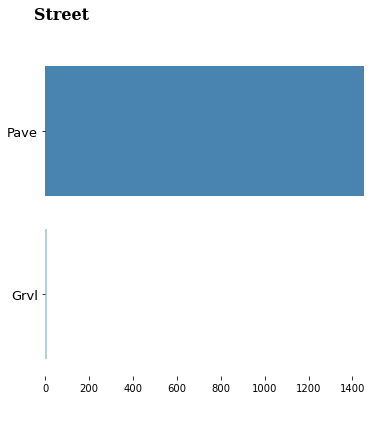

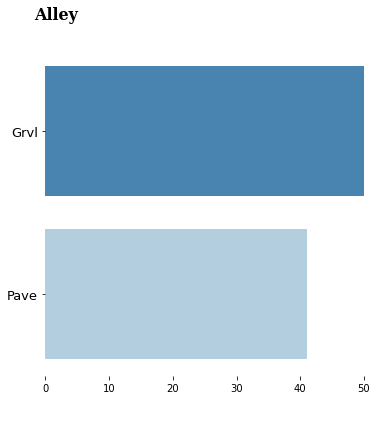

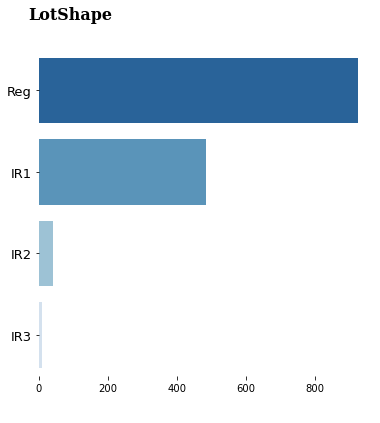

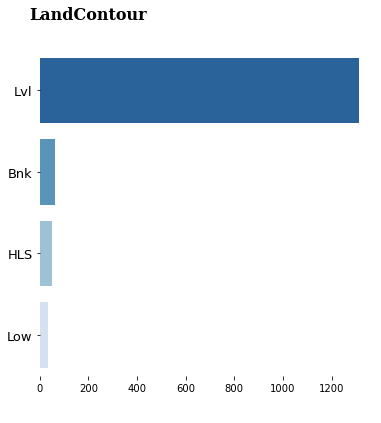

...

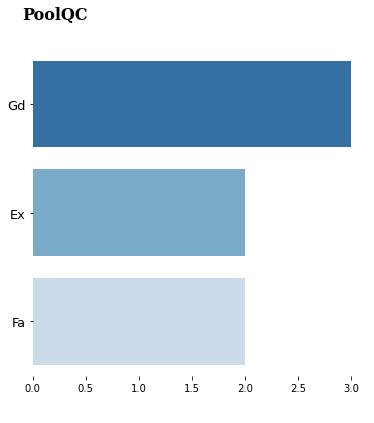

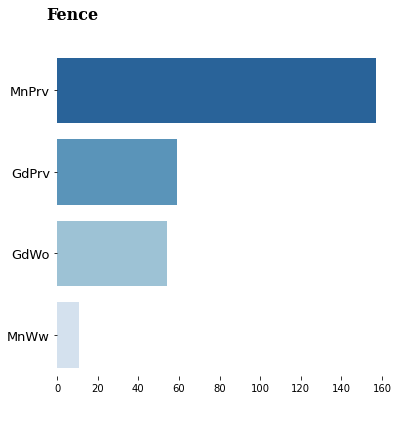

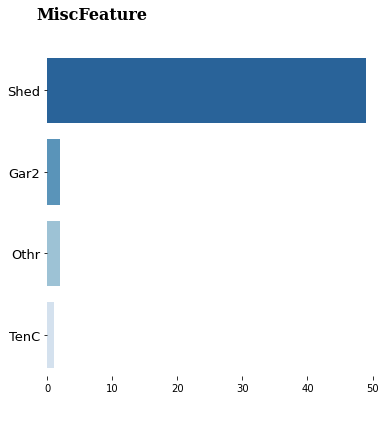

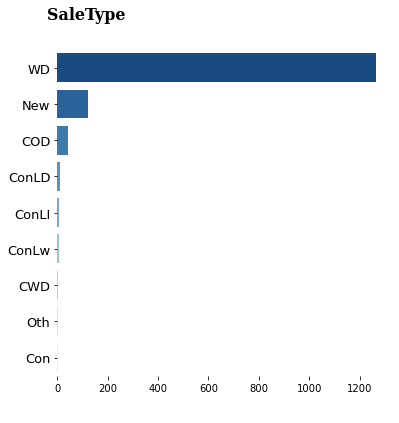

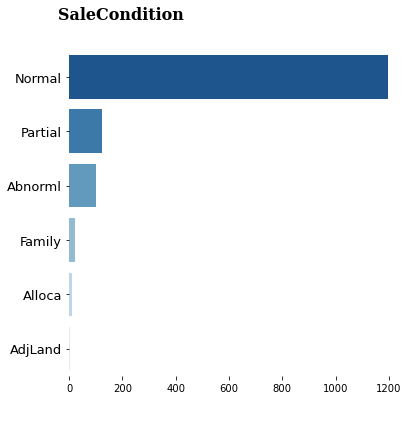

In [78]:

%matplotlib inline
colunas = ['MSZoning','Street','Alley','LotShape','LandContour','Utilities','LotConfig','LandSlope','Neighborhood','Condition1','Condition2','BldgType','HouseStyle','RoofStyle','RoofMatl','Exterior1st','Exterior2nd','MasVnrType','ExterQual','ExterCond','Foundation','BsmtQual','BsmtCond','BsmtExposure','BsmtFinType1','BsmtFinType2','Heating','HeatingQC','CentralAir','Electrical','KitchenQual','Functional','FireplaceQu','GarageType','GarageFinish','GarageQual','GarageCond','PavedDrive','PoolQC','Fence','MiscFeature','SaleType','SaleCondition']
for i in colunas:
    fig, ax = plt.subplots(1,1, figsize=(6,6))
    sns.countplot(y = df[i][1:],data=df.iloc[1:], order=df[i][1:].value_counts().index, palette='Blues_r')
    fig.text(0.1, 0.95,i, fontsize=16, fontweight='bold', fontfamily='serif')
    plt.xlabel(' ', fontsize=20)
    plt.ylabel('')
    plt.yticks(fontsize=13)
    plt.box(False)